## Обработка БД ОПЯ, `знакомство с данными`

P.S. Часть доработки столбцов с датами, которую нельзя было автоматизировать, была произведена вручную в экселе

In [1]:
import numpy as np
import pandas as pd
import geopandas as gpd
from shapely.wkt import loads
import plotly.express as px
import plotly.graph_objects as go
import pickle
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import re  

In [23]:
data = pd.read_excel('files//all_country_events.xlsx')
print(data.shape)
data.head()

(30054, 22)


,_ID,Event_ID,News_link,Text,News_source,News_type,Location_ATD4,Location_other,Location_geocoded,Date_year,...,Phenomena,Event_verbose,Damage_description,Damage_money_num,People_dead_num,People_injured,People_injured_num,Activities,Verification_source,Verification_details
0,373f58e9-3bdc-4444-add0-d391ca3d0eeb,ветер_2018-05_373f58e9,https://www.kommersant.ru/doc/3644850,Действие штормового предупреждения в Москве пр...,СМИ,событие,г. Москва,Парк Горького; Московский зоопарк,да,2018.0,...,сильные ветры,{'интенсивность': 'порывы 15 м/с и выше'},В Москве из-за урагана закрыли Парк Горького и...,NaN,1.0,пострадали 57 человек,57.0,NaN,NaN,NaN
1,f87558cf-e252-417f-b9f9-45cc7dfc5885,ветер_2022-07_f87558cf,https://ria.ru/20220717/pogoda-1803031732.html,"МОСКВА, 17 июл - РИА Новости. Москвичей просят...",СМИ,прогноз/предупреждение,г. Москва,NaN,да,2022.0,...,сильные ветры,{'интенсивность': 'порывы ветра до 17 метров в...,NaN,NaN,NaN,NaN,0.0,В ходе предупреждения о неблагоприятных погодн...,NaN,NaN
2,35e5bf19-2141-4ba2-af76-290622d9c773,ветер_2024-09_35e5bf19,https://ria.ru/20230302/uragan-1855465307.html,"МОСКВА, 2 мар - РИА Новости. Президент России ...",СМИ,прогноз/предупреждение,Курская область,NaN,да,2022.0,...,сильные ветры,NaN,"Ущерб причинен объектам инфраструктуры, жилым ...",NaN,NaN,NaN,0.0,Президент России поручил МЧС оценить ущерб и п...,NaN,NaN
3,ddc7d830-25b7-473f-a6e1-c137250e5115,жара_2023-09_ddc7d830; пожары_2023-09_ddc7d830,https://ria.ru/20230926/voronezh-1898760527.html,"ВОРОНЕЖ, 26 сен - РИА Новости. Спасатели объяв...",СМИ,прогноз/предупреждение,Воронежская область,NaN,да,2023.0,...,жара; ландшафтные пожары,V класс пожарной опасности (чрезвычайная степе...,NaN,NaN,NaN,NaN,0.0,Призыв к закреплению правовых основ наставниче...,NaN,NaN
4,5fff41d0-ff42-49ca-8a4c-f9a15d4cfba8,кнпя_2019-09_5fff41d0,https://www.kommersant.ru/doc/3966271,Десять человек пострадали в Москве при падении...,СМИ,событие,г. Москва,NaN,да,2019.0,...,КНПЯ,При майской норме 51 мм за короткое время выпа...,В результате непогоды в Москве пострадали деся...,NaN,0.0,10 человек пострадали при падении деревьев; го...,10.0,"Предупреждение о грозе было сделано МЧС, синоп...",NaN,NaN


In [19]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30054 entries, 0 to 30053
Data columns (total 22 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   _ID                   30054 non-null  object 
 1   Event_ID              23867 non-null  object 
 2   News_link             30054 non-null  object 
 3   Text                  30054 non-null  object 
 4   News_source           30054 non-null  object 
 5   News_type             30054 non-null  object 
 6   Location_ATD4         29915 non-null  object 
 7   Location_other        26846 non-null  object 
 8   Location_geocoded     30054 non-null  object 
 9   Date_year             29498 non-null  float64
 10  Date_start            26914 non-null  object 
 11  Date_end              13624 non-null  object 
 12  Phenomena             30054 non-null  object 
 13  Event_verbose         22021 non-null  object 
 14  Damage_description    13774 non-null  object 
 15  Damage_money_num   

### Посмртрим на пропуски

In [14]:
df = data
null_counts = df.isnull().sum()
total_counts = df.shape[0]  # Общее количество строк
missing_percentages = (null_counts / total_counts) * 100

missing_df = pd.DataFrame({
    'Column': null_counts.index,
    'Missing Percentage': missing_percentages.values
})


In [15]:
fig = px.bar(missing_df, x='Column', y='Missing Percentage',
             title='Процент пропусков в столбцах',
             labels={'Missing Percentage': 'Процент пропусков', 'Column': 'Столбцы'})

fig.show()


In [25]:
# Наполнение всех столбцов БД ОПЯ
for column in data:
    print(data[column].dtypes)
    print(data[column].value_counts())
    print()

object
_ID
1cab03bd-7801-4677-8ad4-3c4ba0001e5a    2
52ef3c9e-a9a7-4424-856f-932fa8f6b47c    1
19ec079e-941f-4973-8fa3-5bc205f4d8bb    1
907c910f-53c4-445b-8465-5ec87a48410b    1
74bd77d9-3156-47d4-aaca-02759f03cc63    1
                                       ..
453b7e27-b4a6-4f79-8e2d-b1b25d470df7    1
516a75fd-2f8c-4c33-89cb-ddfd3219b184    1
a6177233-7e6c-4a98-bfc4-e3aaafe80ad1    1
872ecf5b-7692-4af5-8631-0d3c9fe3d94d    1
5fff41d0-ff42-49ca-8a4c-f9a15d4cfba8    1
Name: count, Length: 30053, dtype: int64

object
Event_ID
наводн_2024-03_9e707ec1                          161
вредит_2016-05_a25fa205                          154
наводн_2024-03_c51871e8                          143
наводн_2024-04_aeb03aef                          115
наводн_2024-04_2bce1378                          112
                                                ... 
осадк_2020-10_61fca4d7                             1
осадк_2019-12_1fdd76c6                             1
град_2019-07_49d4e42b; осадк_2019-07_49d4e42b

### Изменим у столбцов типа float тип на int, а также у столбца `Damage_mney_num` (экономические потери) изменим тип данных с object на float, так как это полностью численный столбец (надо только заменить 1 значение)

In [26]:
data.replace([np.inf, -np.inf], np.nan, inplace=True)  
data['Damage_money_num'] = data['Damage_money_num'].replace('1 миллион 100 тысяч рублей', 1100000)
data[['Date_year',
      'Damage_money_num',
      'People_dead_num',
      'People_injured_num']] = data[['Date_year',
                                     'Damage_money_num',
                                     'People_dead_num',
                                     'People_injured_num']].fillna(0).astype(int)  

In [33]:
data['Date_start'].value_counts().tail(30)

Date_start
2019-09-06      1
январь 2022     1
2015-09-01      1
2015-11-13      1
2015-12-06      1
2015-12-25      1
2015-12-27      1
2015-12-28      1
2016-04-10      1
2016-12-08      1
2016-12-12      1
2017-01-16      1
2017-01-26      1
2017-06-10      1
2018-08-05      1
2020-06-27      1
2022-07-31      1
2024-11-27      1
2014-06-18      1
2014-09-28      1
2024-11-14      1
29-30 4         1
2024-12-08      1
2024-12-15      1
2017-01-13      1
2017-10-01      1
2018-10-07      1
25-26 4         1
2014-01-23      1
24-25 1 2015    1
Name: count, dtype: int64

In [15]:
data['Date_year'].value_counts()

Date_year
2023    6564
2022    5280
2024    5035
2021    4897
2020    2519
2019    1806
2018    1270
2015     584
0        556
2016     503
2014     417
2013     284
2017     283
2012      20
2011      15
2010      11
2006       2
1999       2
2007       1
2003       1
2005       1
2000       1
1997       1
1912       1
Name: count, dtype: int64

### Посмотрим на неверные `Date_start` и `Date_end`, будем выводить оба даже когда только 1 неверное

In [64]:
data['Date_year'] = data['Date_year'].fillna(0).astype(int)
invalid_dates = []
monthes = {'январь': '01', 'февраль': '02', 'март': '03',
 'апрель': '04','май': '05', 'июнь': '06',
 'июль': '07', 'август': '08','сентябрь': '09',
 'октябрь': '10', 'ноябрь': '11', 'декабрь': '12'}
# Итерация по индексам и значениям в обеих колонках  
for index in range(len(data)):  
    date_start = data.loc[index, 'Date_start']  
    date_end = data.loc[index, 'Date_end'] 
    date_year = data.loc[index, 'Date_year'] 
    app = False
    # Проверка Date_start  
    try:  
        pd.to_datetime(date_start)
    except Exception:
        for i in date_start.split():
            if i in monthes:
                date_start = date_start.replace(i, monthes[i])
                data.loc[index, 'Date_start'] = date_start
        app = True
 

    # Проверка Date_end  
    try:  
        pd.to_datetime(date_end)  
    except Exception:
        for i in date_end.split():
            if i in monthes:
                date_end = date_end.replace(i, monthes[i])
                data.loc[index, 'Date_end'] = date_end
        app = True
        
    if date_year == 0 or date_year < 2000:

        try:  
            year = pd.to_datetime(date_start).year
            data.loc[index, 'Date_year'] = year 
        except Exception:
            try:
                year = pd.to_datetime(date_end).year
                data.loc[index, 'Date_year'] = year 
            except Exception:
                
                try:
                    year = re.search(r'(\d{4})', date_end).group(1)
                    data.loc[index, 'Date_year'] = year
                except Exception:
                    app = True
                    year = 0
        date_year = year
    if app is True:
        invalid_dates.append((date_start, date_end, date_year)) 

invalid_dates_df = pd.DataFrame(invalid_dates, columns=['Invalid Date Start', 'Invalid Date End', 'Invalid Date Year'])

years_df = pd.DataFrame(years, columns=['Invalid Date Start', 'Invalid Date End', 'Invalid Date Year'])

print(invalid_dates_df)

C:\Users\Mariia\AppData\Local\Temp\ipykernel_9548\3322605957.py:39: UserWarning: Parsing dates in %d %m %Y format when dayfirst=False (the default) was specified. Pass `dayfirst=True` or specify a format to silence this warning.
  year = pd.to_datetime(date_start).year


    Invalid Date Start            Invalid Date End  Invalid Date Year
0        03-04.06.2017                         NaN             2017.0
1              22-23 5                         NaN             2017.0
2                45390                         NaN             2024.0
3                  NaN      до полуночи 2020-01-31             2020.0
4           2022-07-07     до конца дня 2022-07-07             2022.0
..                 ...                         ...                ...
167         с конца 10                         NaN             2023.0
168                NaN                     17-18 5             2024.0
169            04 2024                     04 2024             2024.0
170            04 2023                         NaN             2023.0
171                NaN  конец недели (январь 2019)                NaN

[172 rows x 3 columns]


In [37]:
invalid_dates_df.head(50)

,Invalid Date Start,Invalid Date End,Invalid Date Year
0,03-04.06.2017,NaN,2017.0
1,22-23 5,NaN,2017.0
2,NaN,05 2018,2018.0
3,05 2018,05 2018,2018.0
4,45390,NaN,2024.0
5,NaN,до полуночи 2020-01-31,2020.0
6,2022-07-07,до конца дня 2022-07-07,2022.0
7,04,NaN,2020.0
8,NaN,до четверга,NaN
9,NaN,до четверга,2024.0


In [ ]:
monthes = ['январь', 'февраль', 'март',
 'апрель','май', 'июнь',
 'июль', 'август','сентябрь',
 'октябрь', 'ноябрь', 'декабрь']
stroke.split()

In [6]:
lst = []
for index, value in data['Date_start'].items():  
    try:  
        # Пробуем преобразовать в дату  
        pd.to_datetime(value)  
    except Exception as e:  
        lst.append(value)
print(lst)

['03-04.06.2017', '22-23 5', 'май 2018', '45390', 'апрель', '2020-04-31', 'апрель 2022', 'август 2021', 'июль 2015', 'май 2014', 'апрель 2014', 'январь 2014', 'сентябрь 2013', 'август 2013', 'август 2013', 'май 2013', 'апрель 2011', 'апрель 2010', 'март 2016', 'февраль 2015', '13-14 1 2015', '10 11 2013 г.', '27-28 8', 'ноябрь', '23-24 9', '15-16 12 2023', 'август 2023', 'август 2023', 'апрель', 'апрель 2023', 'апрель 2022', 'апрель 2021', 'март 2021', '15 8 2016 года', '04 5 2024 года', '19 7 2023 года', '18 август 2014', 'октябрь 2015', 'сентябрь 2015', 'июнь 2015', '7 4 2018 года', '24-25 8 2017', 'август 2014', 'август 2014', 'август 2014', 'август 2014', 'август 2014', 'август 2014', 'сентябрь 2015', '15 6 2022 г', '20 4 2021 г.', '19 4 2021 года', '22 4 2018 г.', 'по долгосрочному прогнозу вскрытие реки вятки ожидают в конце второй – начале третьей декады 4', 'апрель 2022', 'февраль 2021', 'апрель 2021', 'январь 2021 года', '19 2 2023 года', 'апрель 2024', 'апрель 2019', 'апрель 

In [8]:
len(lst)

157

In [7]:
lst_end = []
for index, value in data['Date_end'].items():  
    try:  
        # Пробуем преобразовать в дату  
        pd.to_datetime(value)  
    except Exception as e:  
        lst_end.append(value)
print(lst_end)

['май 2018', 'май 2018', 'до полуночи 2020-01-31', 'до конца дня 2022-07-07', 'до четверга', 'до четверга', 'до четверга', '12 дня понедельника', 'май 2021 года', '2020-04-31', 'июль 2015', 'март 2016', 'февраль 2015', '11 11 2013 г.', 'декабрь', '16-17 5', 'конец 12', '14-16 7', '18 8 2016 года', '24 7 2023 года', '8 4 2018 года', 'август 2014', 'август 2014', 'август 2014', '15 6 2022 г', '21 4 2021 г.', '19 4 2021 года', '22 4 2018 г.', '01-03 часа 30 7', '20 2 2023 года', 'февраль', '2 5 2024 г.', '2023-11-20 24:00', 'до 4', 'начало 4', 'апрель 2021', '02 5 2023 года', 'первая декада 4', 'конец недели', 'конец недели', 'апрель', '12 7 2023 года', 'февраль 2023', 'апрель', 'август', '14-16 10', '12 9 2023 года', '10–11 12', 'до конца дня', 'до конца дня 2023-10-05', 'апрель 2022', 'до понедельника', 'до 5 6', 'до вечера пятницы', 'апрель 2021', 'до понедельника', 'конец 1', 'до конца сегодняшнего дня', 'май 2021', 'декабрь', 'до субботы', 'до субботы', '25 11 2022 года', 'апрель 202

In [9]:
len(lst_end)

84

In [97]:
# Загружаем еще одну версию базы, где частично были даты постов
data_start = pd.read_excel('files//posts.xlsx')
data_start.head()

,ФО,ID,Заголовок,Ссылка,Текст сообщения,Дата сообщения,Источник,Text_phenomena,flag_phenomena,chatgpt_news_type,...,"Район, аймак, кожуун, улус, городской округ",Координаты,Location_flag,Вид ОПЯ,flag_phenomena_gpt,chatgpt_start_month,chatgpt_end_month,Число потерпевших,ID угроз в сообщении,Число угроз в сообщении
0,ЮФО,0064fdae-c125-4d5c-99eb-1c5d791b7ece,NaN,https://vk.com/wall-69592478_105724,"МЧС Крыма напоминает, что согласно прогнозу се...",2023-02-08 11:30,ВКонтакте,['КНПЯ'],простая,прогноз/предупреждение,...,[],"['POINT (33.0877417 45.2657178)', 'POINT (34.3...",Сложная,['сильные осадки'],простая,2,2,NaN,['осадк_2023-02_0064fdae'],1
1,ЮФО,eaaadb22-b273-4d79-adf3-c860dfec8d88,NaN,https://vk.com/wall-90422809_10309,‼️ Из-за снегопада ограничено движение на учас...,2023-02-08 16:42,ВКонтакте,['сильные осадки'],простая,прогноз/предупреждение,...,"['Ялта', 'Судак']","['POINT (35.1010449 44.8764433)', 'POINT (34.2...",Сложная,['сильные осадки'],простая,2,Не указано,NaN,['осадк_2023-02_bf62c89c'],1
2,СЗФО,d6d7bf29-c43f-42a0-90f0-d49ae04457cc,05 сентября 1999 года. Смерч в Котласе,https://29.mchs.gov.ru/deyatelnost/press-centr...,Город Котлас. В результате ночного кратковреме...,"5 сентября 1999, 00:00",МЧС,[],Не распознано,событие,...,[],['POINT (46.647629 61.252151)'],"Простая, точка",['сильные ветры'],простая,9,Не указано,2,['ветер_1999-09_d6d7bf29'],1
3,ЮФО,9ad96833-633b-4392-8a60-b341b51a20a3,NaN,https://vk.com/wall-172754025_23930,#ВАЖНО 💨В Югре продолжаются морозы. Темпера...,2024-01-13 8:00,ВКонтакте,['мороз'],простая,прогноз/предупреждение,...,[],['POINT (74.4913089 63.0518178)'],Сложная,['мороз'],простая,1,Не указано,0,"['мороз_2024-01_88ee6060', 'мороз_2024-01_9ad9...",2
4,ПФО,9d958a30-a26a-4141-ace6-7c7d0e977bc2,NaN,https://vk.com/wall-150224538_24969,ЕДДС информирует Ночью и утром 10 января 2024 ...,2024-01-09 12:23,ВКонтакте,"['сильные осадки', 'гололед', 'мороз']",сложная,прогноз/предупреждение,...,['Балезинский муниципальный район'],"['POLYGON ((53.791308 58.455029, 53.786311 58....",Сложная,"['гололед', 'мороз']",сложная,1,1,0,"['мороз_2024-01_8a95bb12', 'мороз_2024-01_436c...",3


In [141]:
result = pd.merge(data_start[['ID', 'Дата сообщения']],
                  data, left_on='ID', right_on = '_ID', how='right')
result = result.drop('ID', axis=1)
result = result.drop('Unnamed: 0', axis=1)
result = result.rename(columns={'Дата сообщения': 'Date_post'})
data = result.copy()

In [80]:
def form(value):
    return str(value).split()[0]
data['Date_start'] = data['Date_start'].apply(form)
data['Date_end'] = data['Date_end'].apply(form)

In [81]:
data[['Date_start',
      'Date_end']] = data[['Date_start',
                           'Date_end']].apply(pd.to_datetime, format='%Y-%m-%d')

In [169]:
# исправляем даты

def fix_dates(data):
    """
    Функция для исправления дат в колонках Date_start и Date_end.
    
    :param data: DataFrame с колонками 'Date_year', 'Date_start', 'Date_end'
    :return: исправленные колонки 'Date_start' и 'Date_end'
    """
    def adjust_dates(row):
        year = row['Date_year']
        start_date = row['Date_start']
        end_date = row['Date_end']
        if pd.notnull(end_date):
            if end_date.year != year:
                end_date = end_date.replace(year=year)
        # Проверка на ненулевые даты
        if pd.notnull(start_date):
            if start_date.year != year:
                start_date = start_date.replace(year=year)
        
        if pd.notnull(end_date) and pd.notnull(start_date):
            delta = int(str(end_date - start_date).split()[0])
            if delta < 0:
                start_date = start_date.replace(year=year-1)


        
        return pd.Series([start_date, end_date])
    
    # Применяем функцию ко всем строкам DataFrame
    return data.apply(adjust_dates, axis=1)

data[['fix_Date_start', 'fix_Date_end']] = fix_dates(data)

In [170]:
pd.DataFrame(data['Date_year'] == data['Date_start'].dt.year).value_counts()

0    
True     26434
False     3622
Name: count, dtype: int64

In [171]:
pd.DataFrame(data['Date_year'] == data['fix_Date_start'].dt.year).value_counts()

0    
True     26900
False     3156
Name: count, dtype: int64

In [172]:
pd.DataFrame(data['Date_year'] == data['Date_end'].dt.year).value_counts()

0    
False    16611
True     13445
Name: count, dtype: int64

In [173]:
pd.DataFrame(data['Date_year'] == data['fix_Date_end'].dt.year).value_counts()

0    
False    16133
True     13923
Name: count, dtype: int64

In [174]:
data['Date_period'] = data['fix_Date_end']-data['fix_Date_start']

In [175]:
data.columns

Index(['Date_post', '_ID', 'Event_ID', 'News_link', 'Text', 'News_source',
       'News_type', 'Location_ATD4', 'Location_other', 'Location_geocoded',
       'Date_year', 'Date_start', 'Date_end', 'Phenomena', 'Event_verbose',
       'Damage_description', 'Damage_money_num', 'People_dead_num',
       'People_injured', 'People_injured_num', 'Activities',
       'Verification_source', 'Verification_details', 'fix_Date_start',
       'fix_Date_end', 'Date_period'],
      dtype='object')

In [176]:
data.sort_values(by = 'Date_period', ascending = True)[['Date_year',
                                                            'Date_start',
                                                            'Date_end',
                                                            'fix_Date_start',
                                                            'fix_Date_end',
                                                            'Date_period',
                                                            'Date_post']].head(50)

,Date_year,Date_start,Date_end,fix_Date_start,fix_Date_end,Date_period,Date_post
30055,2024,2024-04-27,2024-04-27,2024-04-27,2024-04-27,0 days,2024-04-27 11:12
9804,2016,2016-08-15,2016-08-15,2016-08-15,2016-08-15,0 days,"15 августа 2016, 08:35"
9805,2016,2016-08-14,2016-08-14,2016-08-14,2016-08-14,0 days,"14 августа 2016, 13:10"
22204,2021,2021-12-21,2021-12-21,2021-12-21,2021-12-21,0 days,2021-12-21 13:34
22203,2022,2022-01-17,2022-01-17,2022-01-17,2022-01-17,0 days,2022-01-17 10:27
22199,2023,2023-12-31,2023-12-31,2023-12-31,2023-12-31,0 days,2023-12-31 11:25
22198,2021,2021-05-18,2021-05-18,2021-05-18,2021-05-18,0 days,2021-05-19 12:52
22197,2021,2021-12-16,2021-12-16,2021-12-16,2021-12-16,0 days,2021-12-16 17:30
22195,2023,2023-12-31,2023-12-31,2023-12-31,2023-12-31,0 days,2023-12-31 13:03
22193,2023,2023-12-31,2023-12-31,2023-12-31,2023-12-31,0 days,2023-12-31 11:59


In [5]:
data.sort_values(by = 'Date_period', ascending = True)[['Date_year',
                                                            'Date_start',
                                                            'Date_end',
                                                            'fix_Date_start',
                                                            'fix_Date_end',
                                                            'Date_period',
                                                            'Date_post']].head(50)

,Date_year,Date_start,Date_end,fix_Date_start,fix_Date_end,Date_period,Date_post
13711,2019,2019-10-12,2019-12-10,2019-12-10,2019-12-10,0 days,2019-12-10 13:52
11302,2019,2019-03-16,2019-03-16,2019-03-16,2019-03-16,0 days,"16 марта 2019, 13:55"
11301,2019,2019-03-16,2019-03-16,2019-03-16,2019-03-16,0 days,"16 марта 2019, 16:57"
11300,2019,2019-03-16,2019-03-16,2019-03-16,2019-03-16,0 days,"16 марта 2019, 18:05"
11299,2019,2019-03-01,2019-03-01,2019-03-01,2019-03-01,0 days,"18 марта 2019, 13:02"
11298,2019,2019-03-01,2019-03-01,2019-03-01,2019-03-01,0 days,"18 марта 2019, 14:11"
11297,2019,2019-03-18,2019-03-18,2019-03-18,2019-03-18,0 days,"18 марта 2019, 15:35"
11296,2019,2019-03-18,2019-03-18,2019-03-18,2019-03-18,0 days,"18 марта 2019, 18:05"
11295,2019,2019-03-20,2019-03-20,2019-03-20,2019-03-20,0 days,"20 марта 2019, 14:26"
11294,2019,2019-03-20,2019-03-20,2019-03-20,2019-03-20,0 days,"20 марта 2019, 15:09"


In [8]:
import pandas as pd  


# Преобразуем столбец в тип bool  
data['Location_geocoded_bool'] = data['Location_geocoded'].map({'да': True, 'нет': False})  

data = data[['_ID', 'Event_ID', 'News_link', 'Text', 'News_source', 'News_type',
       'Location_ATD4', 'Location_other', 'Location_geocoded','Location_geocoded_bool', 'Phenomena',
       'Event_verbose', 'Damage_description', 'Damage_money_num',
       'People_dead_num', 'People_injured', 'People_injured_num', 'Activities',
       'Verification_source', 'Verification_details', 'Date_year',
       'Date_start', 'Date_end', 'fix_Date_start', 'fix_Date_end',
       'Date_period', 'Date_post']]

### Phenomena
`Облако слов типов ОПЯ в БД ОПЯ`

In [34]:
data['Phenomena']

0                                   сильные ветры
1                                      наводнение
2                                  сильные осадки
3                                  сильные осадки
4        наводнение; засуха; град; сильные осадки
                           ...                   
30051                                        КНПЯ
30052                                     гололед
30053                               сильные ветры
30054                                     гололед
30055                              гололед; мороз
Name: Phenomena, Length: 30056, dtype: object

In [11]:
def to_ph_dict(value):
    if isinstance(value, str) and value:
        for i in re.split(r'[;,]', value):
            i = i.strip()
            if i and i[0].isalpha():
                if i in ph_dict:
                    ph_dict[i] += 1
                else:
                    ph_dict[i] = 1
    else:
        if 'nothing' in ph_dict:
            ph_dict['nothing'] += 1
        else:
            ph_dict['nothing'] = 1            
ph_dict = {}
data['Phenomena'].apply(to_ph_dict)
print(f'Длина словаря с ОПЯ: {len(ph_dict)}')

Длина словаря с ОПЯ: 21


In [12]:
phenomena_df = pd.DataFrame(columns = ['ОПЯ', 'Количество'], data = sorted(ph_dict.items(), key = lambda x: x[1], reverse = True))
phenomena_df

,ОПЯ,Количество
0,сильные осадки,8440
1,КНПЯ,6540
2,гололед,5185
3,наводнение,4933
4,сильные ветры,3090
5,град,2940
6,ландшафтные пожары,2805
7,мороз,2606
8,заморозки,1160
9,лавины,899


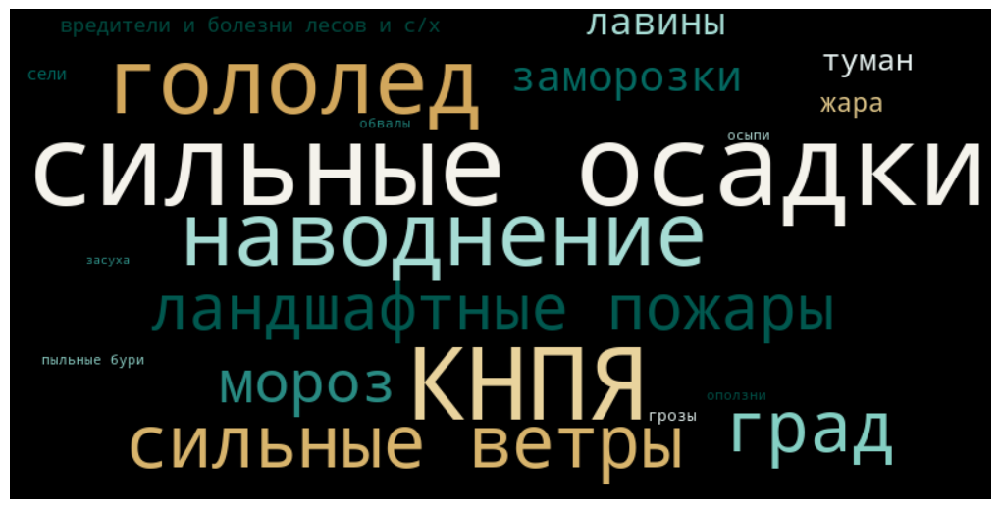

In [15]:
wordcloud = WordCloud(
    width=800,
    height=400,
colormap = 'BrBG',
    background_color='black',
    min_font_size=10,
    max_font_size=100
).generate_from_frequencies(dict(zip(phenomena_df['ОПЯ'], phenomena_df['Количество'])))


plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.subplots_adjust(left=0, right=1, top=1, bottom=0)

plt.show()

### Облако слов типов ОПЯ в выбранном регионе

In [16]:
def to_sub_ph_dict(ph, sub):
    sub_lst = []
    ph_lst = []
    if isinstance(sub, str) and sub:
        for i in re.split(r'[;,]', sub):
            i = i.strip()
            if i and i[0].isalpha():
                sub_lst.append(i)

    else:
        sub_lst.append('_')
    if isinstance(ph, str) and ph:
        for i in re.split(r'[;,]', ph):
            i = i.strip()
            if i and i[0].isalpha():
                ph_lst.append(i)

    else:
        ph_lst.append('_')
    for s in sub_lst:
        if s not in sub_ph_dict:
           sub_ph_dict[s]={}
        for p in ph_lst:
            if p in sub_ph_dict[s]:
                sub_ph_dict[s][p]+=1
            else:
                sub_ph_dict[s][p]=1
          


sub_ph_dict = {}

data.apply(lambda row: to_sub_ph_dict(row['Phenomena'], row['Location_ATD4']), axis=1)

print(f'Длина словаря с ОПЯ: {len(sub_ph_dict)}')

Длина словаря с ОПЯ: 86


In [17]:
sub_ph_dict = dict(sorted(sub_ph_dict.items()))

In [212]:
# with open('files//sub_ph_dict.pkl', 'wb') as file:
#     pickle.dump(sub_ph_dict, file)

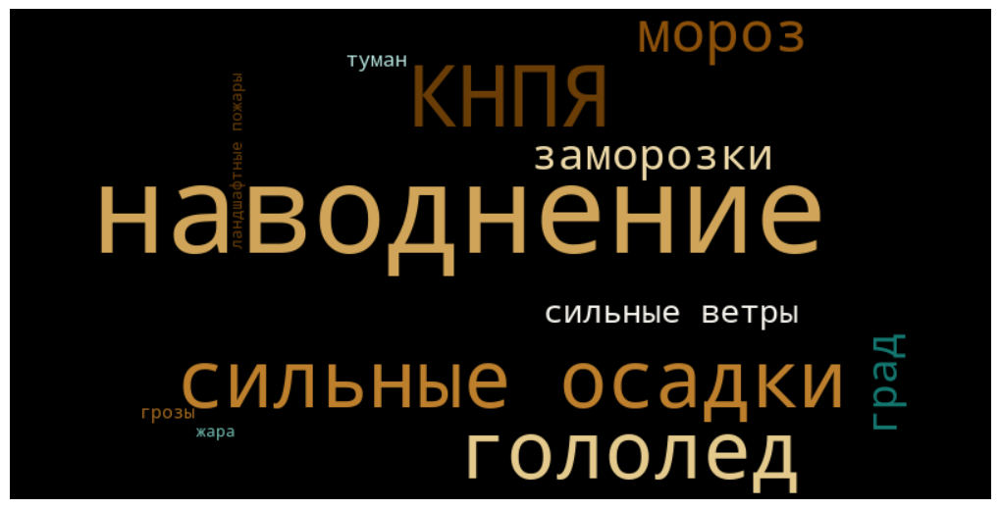

In [201]:
wordcloud = WordCloud(
    width=800,
    height=400,
colormap = 'BrBG',
    background_color='black',
    min_font_size=10,
    max_font_size=100
).generate_from_frequencies(sub_ph_dict['Вологодская область'])


plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.subplots_adjust(left=0, right=1, top=1, bottom=0)

plt.show()

### Облако слов регионов, в которых наблюдалось выбранное ОПЯ

In [19]:
def to_ph_sub_dict(ph, sub):
    sub_lst = []
    ph_lst = []
    if isinstance(sub, str) and sub:
        for i in re.split(r'[;,]', sub):
            i = i.strip()
            if i and i[0].isalpha():
                sub_lst.append(i)

    else:
        sub_lst.append('_')
    if isinstance(ph, str) and ph:
        for i in re.split(r'[;,]', ph):
            i = i.strip()
            if i and i[0].isalpha():
                ph_lst.append(i)

    else:
        ph_lst.append('_')
    for p in ph_lst:
        if p not in ph_sub_dict:
           ph_sub_dict[p]={}
        for s in sub_lst:
            if s in ph_sub_dict[p]:
                ph_sub_dict[p][s]+=1
            else:
                ph_sub_dict[p][s]=1
          


ph_sub_dict = {}

data.apply(lambda row: to_ph_sub_dict(row['Phenomena'], row['Location_ATD4']), axis=1)

print(f'Длина словаря с ОПЯ: {len(ph_sub_dict)}')

Длина словаря с ОПЯ: 21


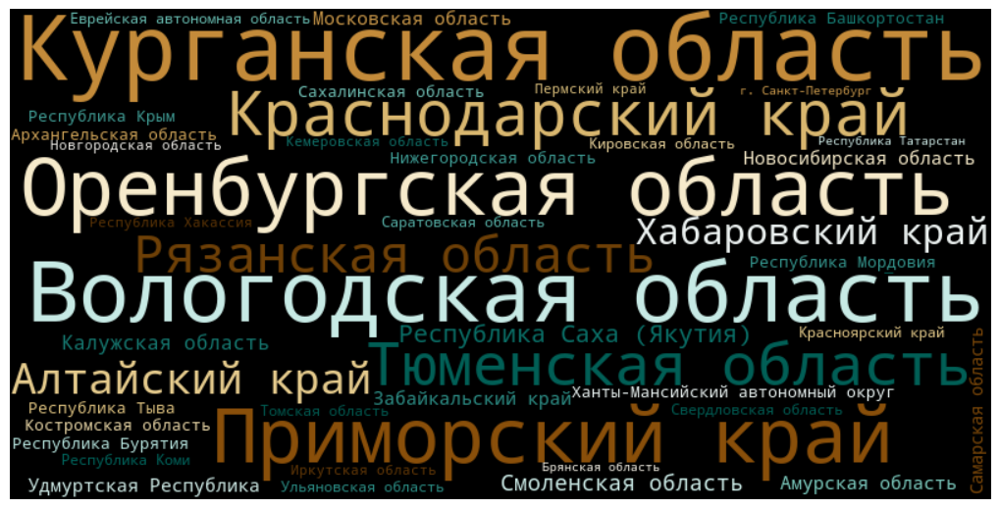

In [20]:
wordcloud = WordCloud(
    width=800,
    height=400,
colormap = 'BrBG',
    background_color='black',
    min_font_size=10,
    max_font_size=100
).generate_from_frequencies(ph_sub_dict['наводнение'])


plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.subplots_adjust(left=0, right=1, top=1, bottom=0)

plt.show()

In [30]:
ph_sub_dict = dict(sorted(ph_sub_dict.items(), key=lambda item: sum(item[1].values()), reverse=True))

In [31]:
ph_sub_dict.keys()

dict_keys(['сильные осадки', 'КНПЯ', 'гололед', 'наводнение', 'сильные ветры', 'град', 'ландшафтные пожары', 'мороз', 'заморозки', 'лавины', 'туман', 'жара', 'вредители и болезни лесов и с/х', 'сели', 'грозы', 'обвалы', 'оползни', 'осыпи', 'пыльные бури', 'засуха', 'термокарст и деградация мерзлоты'])

In [32]:
# # Сохранение словаря в файл
# with open('files//ph_sub_dict.pkl', 'wb') as file:
#     pickle.dump(ph_sub_dict, file)


### Location_ATD4
`Облако слов регионов РФ в БД ОПЯ`

In [71]:
def to_locATD_dict(value):
    if isinstance(value, str) and value:
        for i in re.split(r'[;,]', value):
            i = i.strip()
            if i and i[0].isalpha():
                if i in locATD_dict:
                    locATD_dict[i] += 1
                else:
                    locATD_dict[i] = 1
    else:
        if 'nothing' in locATD_dict:
            locATD_dict['nothing'] += 1
        else:
            locATD_dict['nothing'] = 1            
locATD_dict = {}
data['Location_ATD4'].apply(to_locATD_dict)
print(f'Длина словаря с АТД: {len(locATD_dict)}')

Длина словаря с АТД: 86


In [72]:
sub_df = pd.DataFrame(columns = ['Субъект', 'Количество'],
             data = sorted(locATD_dict.items(), key = lambda x: x[1], reverse = True))
sub_df 

,Субъект,Количество
0,Московская область,1700
1,Краснодарский край,1600
2,Приморский край,1212
3,Астраханская область,867
4,Вологодская область,851
...,...,...
81,Чукотский автономный округ,53
82,Пензенская область,46
83,Ивановская область,38
84,г. Севастополь,25


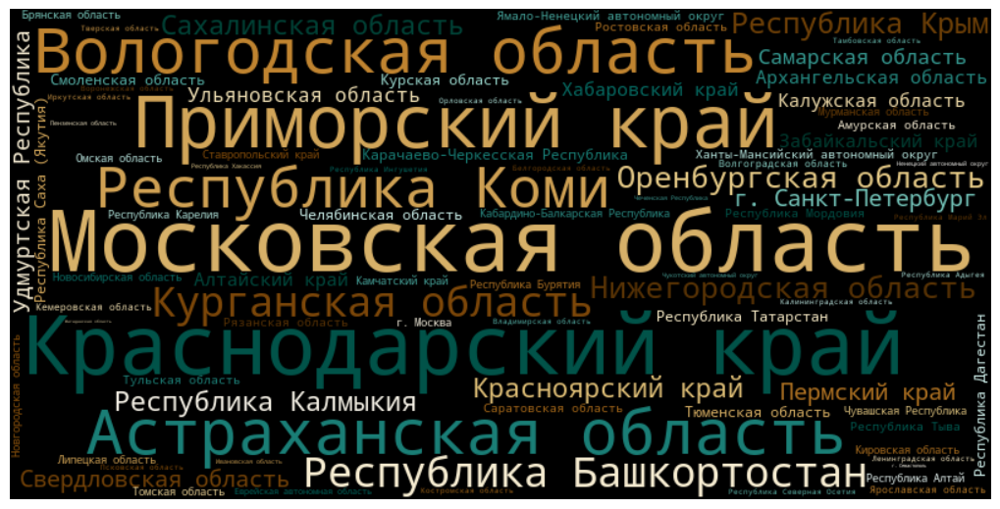

In [122]:
sub_df_drop = sub_df[sub_df['Субъект']!='nothing']

wordcloud = WordCloud(
    width=800,
    height=400,
colormap = 'BrBG',
    background_color='black',
    min_font_size=2,
    max_font_size=70
).generate_from_frequencies(dict(zip(sub_df_drop['Субъект'], sub_df_drop['Количество'])))


plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.subplots_adjust(left=0, right=1, top=1, bottom=0)

plt.show()

### Location_other
`Облако слов более подробных локаций ОПЯ`

In [114]:
def to_locOTHER_dict(value):
    if isinstance(value, str) and value:
        for i in re.split(r'[;,]', value):
            i = i.strip()
            if i and i[0].isalpha():
                if i in locOTHER_dict:
                    locOTHER_dict[i] += 1
                else:
                    locOTHER_dict[i] = 1
    else:
        if 'nothing' in locOTHER_dict:
            locOTHER_dict['nothing'] += 1
        else:
            locOTHER_dict['nothing'] = 1
            
locOTHER_dict = {}
data['Location_other'].apply(to_locOTHER_dict)
print(f'Длина словаря с локациями: {len(locOTHER_dict)}')

Длина словаря с локациями: 11675


In [115]:
loc_df = pd.DataFrame(columns = ['Локация', 'Количество'],
             data = sorted(locOTHER_dict.items(), key = lambda x: x[1], reverse = True))
loc_df

,Локация,Количество
0,nothing,3208
1,г. Санкт-Петербург,404
2,г. Астрахань,320
3,Курган,269
4,Владивосток,266
...,...,...
11670,город Надым,1
11671,Пурпе,1
11672,п. Тазовский,1
11673,сеяхинская тундра,1


In [134]:
cloud = phenomena_df.copy()
cloud.columns = ['word', 'num']
cloud_drop = cloud[cloud['word'] != 'nothing']
dict(zip(cloud_drop['word'], cloud_drop['num']))
# dict(zip(phenomena_df['ОПЯ'], phenomena_df['Количество']))

{'сильные осадки': 8440,
 'КНПЯ': 6540,
 'гололед': 5185,
 'наводнение': 4933,
 'сильные ветры': 3090,
 'град': 2940,
 'ландшафтные пожары': 2805,
 'мороз': 2606,
 'заморозки': 1160,
 'лавины': 899,
 'туман': 541,
 'жара': 360,
 'вредители и болезни лесов и с/х': 222,
 'сели': 131,
 'грозы': 118,
 'оползни': 81,
 'осыпи': 81,
 'обвалы': 81,
 'пыльные бури': 74,
 'засуха': 67,
 'термокарст и деградация мерзлоты': 1}

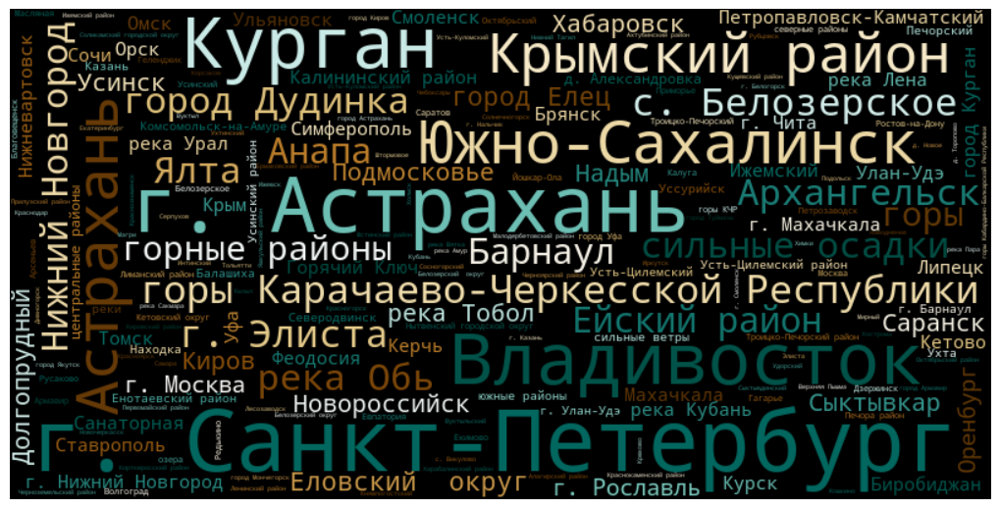

In [118]:
loc_df_drop = loc_df[loc_df['Локация']!='nothing']

wordcloud = WordCloud(
    width=800,
    height=400,
colormap = 'BrBG',
    background_color='black',
    min_font_size=2,
    max_font_size=70
).generate_from_frequencies(dict(zip(loc_df_drop['Локация'], loc_df_drop['Количество'])))


plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.subplots_adjust(left=0, right=1, top=1, bottom=0)

plt.show()

In [125]:
# phenomena_df.to_csv('files//phenomena_df.csv', index = False)
# sub_df.to_csv('files//sub_df.csv', index = False)
# loc_df.to_csv('files//loc_df.csv', index = False)

### Event_verbose
`Описательные сведения о протекании природного явления - интенсивности, площади, причинах возникновения и т.п.`

In [113]:
# value = re.sub(r"[{}:;[\]']", ' ', value)  # Убираем фигурные скобки, двоеточия, квадратные скобки и апострофы
def to_evVerb_dict(value):
    if isinstance(value, str) and value:
        value = str(value.lower())
        for i in  re.sub(r"[{}:;[\]']", ' ', value):
            i = i.strip()
            if i:
                if i in evVerb_dict:
                    evVerb_dict[i] += 1
                else:
                    evVerb_dict[i] = 1
    else:
        if 'nothing' in evVerb_dict:
            evVerb_dict['nothing'] += 1
        else:
            evVerb_dict['nothing'] = 1
            
evVerb_dict = {}
data['Event_verbose'].apply(to_evVerb_dict)
print(f'Длина словаря с подробностями ОПЯ: {len(evVerb_dict)}')

Длина словаря с подробностями ОПЯ: 114


In [122]:
def to_evVerb_dict(value):  
    if isinstance(value, str) and value:  
        value = str(value.lower())  

        value = re.sub(r"[{}[\]']", ' ', value)  # Убираем фигурные скобки и квадратные скобки  
        
 
        phrases = re.split(r'[;,]', value)  # Разделение по ; и ,  
        
        for phrase in phrases:  
            phrase = phrase.strip()
            if phrase:
                if phrase in evVerb_dict:  
                    evVerb_dict[phrase] += 1  
                else:  
                    evVerb_dict[phrase] = 1  
    else:  
        if 'nothing' in evVerb_dict:  
            evVerb_dict['nothing'] += 1  
        else:  
            evVerb_dict['nothing'] = 1  

evVerb_dict = {}  
data['Event_verbose'].apply(to_evVerb_dict)  
print(f'Длина словаря с подробностями ОПЯ: {len(evVerb_dict)}')  

Длина словаря с подробностями ОПЯ: 35650


In [123]:
pd.DataFrame(columns = ['Детали ОПЯ', 'Количество'],
             data = sorted(evVerb_dict.items(), key = lambda x: x[1], reverse = True)).head(30)

,Детали ОПЯ,Количество
0,nothing,8035
1,град,504
2,грозы,495
3,метель,446
4,ливень в сочетании с грозой,280
5,ливни,278
6,чрезвычайная пожарная опасность 5 класса,268
7,мокрый снег,255
8,гроза,247
9,ливень,233


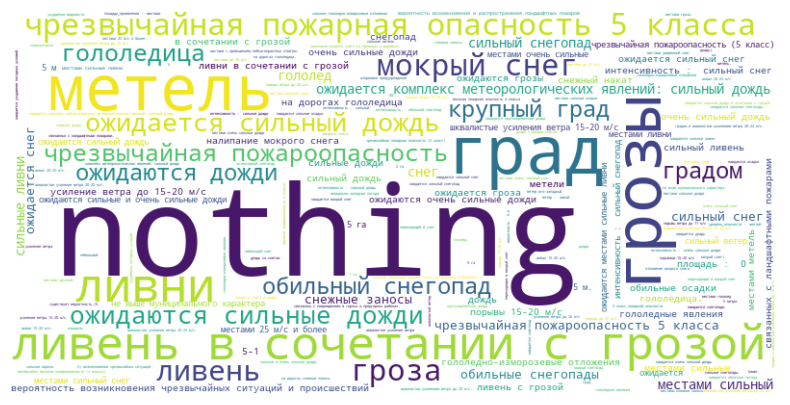

In [124]:
from wordcloud import WordCloud  
import matplotlib.pyplot as plt  

wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(evVerb_dict)  

plt.figure(figsize=(10, 5))  
plt.imshow(wordcloud, interpolation='bilinear')  
plt.axis('off')
plt.show()  

In [23]:
def find_classes(series):  
    return series[series.str.contains(r'5 класс|V класс', regex=True, na=False)]  

filtered_events = find_classes(data['Event_verbose']).unique()
print(f'Длина списка: {len(filtered_events)}')
filtered_events

Длина списка: 576


array(['Ожидается пожарная опасность лесов 5 класс.',
       'Чрезвычайная пожароопасность - 5 класс горимости леса. Ожидаются небольшие кратковременные дожди, местами грозы. Ветер северный 7-12 м/с, при грозах порывы 15-18 м/с.',
       'Чрезвычайная пожарная опасность – 5 класс.',
       'Ожидается гроза, шквалистое усиление ветра при грозе до 15 м/с, высокая пожарная опасность - 4 и 5 класс.',
       'чрезвычайно высокая пожароопасность (V класса)',
       "{'пожароопасность': ['чрезвычайная (5 класс)', 'высокая (4 класс)']}",
       '5 класс горимости',
       'чрезвычайно высокая пожароопасность (V класса) ожидается в связи с установлением сухой и жаркой погоды',
       'чрезвычайная пожарная опасность – 5 класс',
       "{'пожарная_опасность': 'высокая (4 класс), чрезвычайная (5 класс)'}",
       'чрезвычайно высокая пожарная опасность - 5 класс',
       'чрезвычайно высокая пожарная опасность (5 класс)',
       'Чрезвычайно высокая пожарная опасность (5 класс)',
       "{'интенс

### Так данные в столбцах с датами дополнялись еще вне ноутбука, загрузим уже дополненную базу для этой части ноутбука

### Год

In [ ]:
data = pd.read_excel('files_=//data_edited.xlsx')

In [193]:
years = pd.DataFrame(data = data['Date_year'].value_counts()).reset_index()
years.columns = ['Год', 'Число сообщений']
years

,Год,Число сообщений
0,2023,6679
1,2022,5394
2,2024,5139
3,2021,4929
4,2020,2536
5,2019,1829
6,2018,1305
7,2015,592
8,2016,553
9,2014,453


In [196]:
years = years.sort_values(by='Год')
fig = px.line(years, x='Год', y='Число сообщений',
              title='<b>Число сообщений в разные года. БД ОПЯ</b>',
              markers=True,
             color_discrete_sequence=['#01665e'])  

fig.show() 

Самый релевантный для оценки промежуток: `2021 - 2024` гг.
 - 73.67% датасета
 - Сообщения в 2024 году составляют 76.94% от максимума (2023 г)
 - Сообщения в 2022 году составляют 80.76% от максимума (2023 г)
 - Сообщения в 2021 году составляют 73.80% от максимума (2023 г)
 - Сообщения в 2020 году составляют 37.97% от максимума (2023 г), далее этот процент еще сильнее снижается, что вряд-ли говорит о том, что в этом году до 2020 г, включительно, было настолько меньше ОПЯ, просто собрали сильно меньше данных

### Верификация базы

In [90]:
verified = sum(data['Verification_source'].value_counts())
verified_procent = round(verified/len(data)*100, 2)
print(f'Верифицировано {verified} записей')
print(f'Что составляет {verified_procent}% всех данных')

Верифицировано 1933 записей
Что составляет 6.43% всех данных


In [83]:
data['Verification_source'].value_counts()

Verification_source
экспертно                                898
БД Росгидромет                           463
АИС ГМВО (буфер 3 км)                    364
датасет Рослесхоза, датасет МЧС           95
датасет Рослесхоза                        49
датасет МЧС                               37
датасет Рослесхоз                          7
БД РосНедр                                 5
БД Росгидромет; АИС ГМВО (буфер 3 км)      5
БД Росгидромет;                            3
датасет Рослесхоз и датасет МЧС            2
АИС ГМВО (буфер 3 км);                     2
БД Росгидромет; экспертно                  1
датасет Рослесхоза,датасет МЧС             1
датасет Рослесхоз, датасет МЧС             1
Name: count, dtype: int64

In [139]:
def to_verSource_dict(value):
    if isinstance(value, str) and value:
        for i in re.split(r'[;,]|\s+и\s+', value):
            i = i.strip()
            if i and i[0].isalpha():
                if i == 'датасет Рослесхоз':
                    i = 'датасет Рослесхоза'
                if i in verSource_dict:
                    verSource_dict[i] += 1
                else:
                    verSource_dict[i] = 1
    else:
        if 'nothing' in verSource_dict:
            verSource_dict['nothing'] += 1
        else:
            verSource_dict['nothing'] = 1            
verSource_dict = {}
data['Verification_source'].apply(to_verSource_dict)
print(f'Длина словаря с источниками верификации: {len(verSource_dict)}')

Длина словаря с источниками верификации: 7


In [140]:
verify_df = pd.DataFrame(columns = ['Источник', 'Количество'],
             data = sorted(verSource_dict.items(), key = lambda x: x[1], reverse = True))
verify_df

,Источник,Количество
0,nothing,28123
1,экспертно,899
2,БД Росгидромет,472
3,АИС ГМВО (буфер 3 км),371
4,датасет Рослесхоза,155
5,датасет МЧС,136
6,БД РосНедр,5


In [161]:
verify_df_drop = verify_df[verify_df['Источник']!='nothing']
nan = verify_df.loc[verify_df['Источник'] == 'nothing', 'Количество']
if len(nan)>0:
    count = round(nan.values[0]/30056*100, 2)
else:
    count = 0

# Генерация облака слов
fig = px.treemap(verify_df_drop, path=['Источник'], values='Количество',
                 title=f'<b>Источники, использованные для верификации новостей</b>',
                 color='Количество',
                 color_continuous_scale='brbg')
fig.update_traces(textfont=dict(size=20)) 
fig.add_annotation(
    text=f"<b>Не верифицировано: {count} % новостей</b>",
    xref="paper", yref="paper",
    x=-0.08, y=1.1,  # Положение аннотации
    showarrow=False,
    font=dict(size=12, color = 'chocolate')
)
fig.show()

In [163]:
data[data['News_type']=='событие']

,_ID,Event_ID,News_link,Text,News_source,News_type,Location_ATD4,Location_other,Location_geocoded,Location_geocoded_bool,...,Activities,Verification_source,Verification_details,Date_year,Date_start,Date_end,fix_Date_start,fix_Date_end,Date_period,Date_post
0,9dc8dd18-9ad7-4021-b9e1-f47356d16cd4,ветер_2024-04_9dc8dd18,https://vk.com/wall-202031839_11811,🔹В Ангарском округе устраняют последствия непо...,ВКонтакте,событие,Иркутская область,"Ангарск; Савватеевка; СНТ ""Саяны-4""",да,True,...,После начала шквалистого ветра 'Ангарские элек...,NaN,NaN,2024,2024-04-30,2024-01-05,2024-04-30,2024-05-01,1 days,2024-05-01 9:01
1,f0268599-97a1-48a1-81e7-e8eea912dcea,NaN,https://vk.com/wall-165748170_550,ПАВОДОК Сегодня под председательством Руковод...,ВКонтакте,событие,Вологодская область,наводнение,нет,False,...,Под председательством Руководителя администрац...,NaN,NaN,2020,2020-07-05,2020-05-25,2020-05-07,2020-05-25,18 days,NaN
2,460c639d-49ec-48cb-9235-f8064243602c,осадк_2021-11_ea7e4366,https://vk.com/wall-148168105_3653,"Сегодня, 5 декабря, село Найфельд освободилось...",ВКонтакте,событие,Еврейская автономная область,с. Найфельд; с. Петровка; с. Русская поляна,да,True,...,"Улицы села расчистил тяжелый грейдер, который ...",NaN,NaN,2021,2021-11-01,2021-12-05,2021-11-23,2021-12-05,12 days,2021-12-05 10:06
3,a61b8eb6-235d-4758-a3e9-c7933b9310f0,осадк_2019-04_a61b8eb6,https://vk.com/wall-143979448_3340,В Нарьян-Маре проверили качество уборки дорог ...,ВКонтакте,событие,Ненецкий автономный округ,Нарьян-Мар,да,True,...,Вице-губернатор поручил коммунальщикам активиз...,NaN,NaN,2019,2019-04-03,2019-03-03,2019-03-03,2019-03-04,1 days,2019-03-04 13:36
4,b814c921-8daa-4d08-8a47-f265627891bd,наводн_2020-01_b814c921; засуха_2020-01_b814c9...,https://vk.com/wall-196533898_514,"Сельхозпроизводители, потерявшие в 2020 году у...",ВКонтакте,событие,Республика Ингушетия,NaN,да,True,...,"Сельхозпроизводители, потерявшие урожай, получ...",NaN,NaN,2020,2020-01-01,2020-12-31,2020-01-01,2020-12-31,365 days,2020-12-08 12:07:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30051,f8fea93c-5252-4231-bb65-744b19c09633,кнпя_2020-01_f8fea93c,https://vk.com/wall-170887968_2463,⚠️ Дорожные службы районного центра устраняют ...,ВКонтакте,событие,Ямало-Ненецкий автономный округ,п. Тазовский,да,True,...,"20 единиц техники вышли на дороги, рабочие очи...",NaN,NaN,2020,2020-01-01,NaT,2020-01-01,NaT,NaT,2020-01-10 10:36
30052,7c529f0d-b7ce-4156-bb95-8b3736eb970d,NaN,https://vk.com/wall-173311244_7979,🚜 Сегодня в Приуралье выпал первый снег. Комму...,ВКонтакте,событие,Ямало-Ненецкий автономный округ,Приуралье,нет,False,...,Коммунальные службы приступили к работам по от...,NaN,NaN,2023,2023-10-13,NaT,2023-10-13,NaT,NaT,NaN
30053,f1d8e490-65cc-48ef-a556-ecbc4092788c,ветер_2020-04_f1d8e490,https://vk.com/wall-170438171_1461,"Шквальный ветер с порывами до 25 метров, а так...",ВКонтакте,событие,Ямало-Ненецкий автономный округ,Шурышкарский район,да,True,...,"Рейсы вертолетов перенесены, рекомендуется сле...",NaN,NaN,2020,2020-04-08,NaT,2020-04-08,NaT,NaT,2020-04-08 12:25
30054,ecfb032f-ae1e-4c5d-bc79-f8119bc426a3,NaN,https://vk.com/wall-75005231_24441,"Семьям, пострадавшим в сеяхинской тундре, помо...",ВКонтакте,событие,Ямало-Ненецкий автономный округ,сеяхинская тундра,нет,False,...,Администрация Ямальского района начала прораба...,NaN,NaN,2021,2021-05-13,NaT,2021-05-13,NaT,NaT,NaN


### Verification_source & Verification_details
`Дополнительные сведения о записи из внешней базы данных`

In [118]:
data_ed3 = data.copy()
data_ed3['Verification_details'] = data_ed3['Verification_details'].fillna('nothing')  
data_ed3['Verification_details'] = data_ed3['Verification_details'].replace('', 'nothing')
data_ed3['Verification_source'] = data_ed3['Verification_source'].fillna('nothing')  
data_ed3['Verification_source'] = data_ed3['Verification_source'].replace('', 'nothing')
data_ed3['Verification_details'].value_counts()

Verification_details
nothing                                                                                                             28972
Ландш.пожары: г. Чита - нет                                                                                            40
Ландш.пожары: Краснокаменский район - да (датасет Рослесхоза, датасет МЧС, )                                           23
Ландш.пожары:  - нет                                                                                                   22
Негидрологическое событие (плювиальное наводнение)                                                                     21
                                                                                                                    ...  
№ 11051: сильные осадки 45 мм                                                                                           1
№ 9128: сильные ветры 28 м/с                                                                                            1
РИА

In [121]:
data_ed3['Verification_source'].value_counts()

Verification_source
nothing                                  28123
экспертно                                  898
БД Росгидромет                             463
АИС ГМВО (буфер 3 км)                      364
датасет Рослесхоза, датасет МЧС             95
датасет Рослесхоза                          49
датасет МЧС                                 37
датасет Рослесхоз                            7
БД РосНедр                                   5
БД Росгидромет; АИС ГМВО (буфер 3 км)        5
БД Росгидромет;                              3
датасет Рослесхоз и датасет МЧС              2
АИС ГМВО (буфер 3 км);                       2
БД Росгидромет; экспертно                    1
датасет Рослесхоза,датасет МЧС               1
датасет Рослесхоз, датасет МЧС               1
Name: count, dtype: int64

In [127]:
ver = pd.DataFrame(data_ed3[['Verification_source',
                            'Verification_details']].value_counts()).reset_index()
ver.columns = ['Источник', 'Детали', 'Количество']
ver.head(20)

,Источник,Детали,Количество
0,nothing,nothing,27941
1,экспертно,nothing,817
2,АИС ГМВО (буфер 3 км),nothing,214
3,nothing,Ландш.пожары: г. Чита - нет,35
4,"датасет Рослесхоза, датасет МЧС",Ландш.пожары: Краснокаменский район - да (дата...,23
5,nothing,Ландш.пожары: - нет,22
6,БД Росгидромет,№ 9971: сильные осадки 27 мм,21
7,АИС ГМВО (буфер 3 км),Негидрологическое событие (плювиальное наводне...,21
8,БД Росгидромет,№ 11389: сильные ветры 38 м/с,19
9,АИС ГМВО (буфер 3 км),Группа событий,18


### Activities
`Меры и мероприятия,`
- предпренимавшиеся до,
- во врмея
- и после события,

`направленные на`

- его предотвращение,
- минимизацию ущерба,
- ликвидацию последствий
- и т.п.

In [130]:
data['Activities'].value_counts()

Activities
Будьте внимательны и осторожны!                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                  178
Будьте осторожны!                                                                                                                                                                                                                                                                                                                                                                                                                                                       

In [356]:
0.3*0.95

0.285

### News_type 

In [171]:
news = pd.DataFrame(data[['News_source', 'News_type']].value_counts()).reset_index()
news.columns = ['Источник', 'Тип', 'Количество']

fig = go.Figure(data=go.Heatmap (
                                    x=news['Источник'],   
                                    y=news['Тип'],   
                                    z=news['Количество'],
                                    colorscale="brbg",
                                    text=news['Количество'],
                                    texttemplate="%{text}",
                                    colorbar=dict(title='<b>Количество новостей</b>')))
fig.update_xaxes(title_text="<b>Источник</b>")
fig.update_yaxes(title_text='<b>Контент</b>')
fig.update_layout(title_text='<b>Источники и новостной контент</b>')

hover_template = '<b>Контент</b>: %{y}<br>' + \
                 '<b>Источник</b>: %{x}<br>' + \
                 '<b>Количество новостей</b>: %{z}<extra></extra>'

fig.update_traces(hovertemplate=hover_template, hoverongaps=False)
# fig.update_layout(height=600, width=1000, margin=dict(t=20))
fig.show()

In [172]:
data['Damage_description'].value_counts()

Damage_description
Существует вероятность возникновения ЧС, связанной с повреждением опор ЛЭП, домов, автомобильных дорог, мостов, повреждением объектов инфраструктуры, нарушением условий жизнеобеспечения населения и непосредственной угрозой жизни и здоровью граждан.                                                                                                       31
Существует вероятность возникновения чрезвычайных ситуаций, не выше муниципального характера, связанных с повреждением в горных и предгорных районах: автомобильных дорог федерального и местного значения, канатных дорог, строений, линий связи и электропередач; травматизмом туристов вне горнолыжных трасс, спортсменов в районах схода снежных лавин.    30
Возрастает вероятность возникновения ЧС и происшествий, связанных с обрывом линий связи и электропередач, нарушением в работе транспорта и жилищно-коммунальных служб, обрушением слабо укрепленных конструкций, рекламных щитов, крыш зданий различного назначения, падения дере

In [173]:
data['Damage_money_num'].value_counts()

Damage_money_num
0              29864
10000             13
301000000          9
50000              5
40000000000        4
               ...  
40000              1
255000             1
92510000           1
735000000          1
16000000           1
Name: count, Length: 137, dtype: int64

### People_dead_num

In [10]:
# смерть - новостной источник

deadNUM = pd.DataFrame(data[['News_source', 'People_dead_num']].value_counts()).reset_index()
deadNUM.columns = ['Источник', 'Число погибших в новости', 'Количество новостей']
deadNUM['Число погибших'] = deadNUM['Число погибших в новости'] * deadNUM['Количество новостей']
deadNUM = deadNUM.groupby(by='Источник').sum()[['Количество новостей', 'Число погибших']].reset_index()
deadNUM['Количество новостей (%)'] = round(deadNUM['Количество новостей']/deadNUM['Количество новостей'].sum()*100, 2)
deadNUM['Число погибших (%)'] = round(deadNUM['Число погибших'] / deadNUM['Число погибших'].sum() * 100, 2) 
deadNUM

,Источник,Количество новостей,Число погибших,Количество новостей (%),Число погибших (%)
0,ВКонтакте,24006,436,79.87,41.41
1,МЧС,5626,14,18.72,1.33
2,СМИ,424,603,1.41,57.26


In [47]:
def to_ph_dead_source_dict(stroke):  
    value = stroke[0]  
    dead = stroke[1]  
    source = stroke[2]  
    
    if isinstance(value, str) and value:  
        for i in re.split(r'[;,]', value):  
            i = i.strip()  
            if i and i[0].isalpha():  
                # Проверяем, существует ли ключ i в словаре  
                if i not in ph_dead_source_dict:  
                    ph_dead_source_dict[i] = {'Количество': 0, 'Погибшие': 0}  
                
                # Увеличиваем счетчики  
                ph_dead_source_dict[i]['Количество'] += 1  
                
                if dead:  
                    ph_dead_source_dict[i]['Погибшие'] += dead  
                
                if source in ph_dead_source_dict[i]:  
                    ph_dead_source_dict[i][source] += 1  
                else:  
                    ph_dead_source_dict[i][source] = 1  

    # else:  
    #     # Обработка случая, когда value пустое  
    #     if 'nothing' not in ph_dead_source_dict:  
    #         ph_dead_source_dict['nothing'] = {'Количество': 0, 'Погибшие': 0}  
    #         ph_dead_source_dict['nothing'][source] = 0  
            
    #     ph_dead_source_dict['nothing']['Количество'] += 1  
        
    #     if dead:  
    #         ph_dead_source_dict['nothing']['Погибшие'] += 1  
            
    #     if source in ph_dead_source_dict['nothing']:  
    #         ph_dead_source_dict['nothing'][source] += 1  

ph_dead_source_dict = {}  
data[['Phenomena', 'People_dead_num', 'News_source']].apply(to_ph_dead_source_dict, axis=1)  
print(f'Длина словаря с ОПЯ? погибшими и новостными источниками: {len(ph_dead_source_dict)}')  

C:\Users\Mariia\AppData\Local\Temp\ipykernel_3828\2637427701.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  value = stroke[0]
C:\Users\Mariia\AppData\Local\Temp\ipykernel_3828\2637427701.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  dead = stroke[1]
C:\Users\Mariia\AppData\Local\Temp\ipykernel_3828\2637427701.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  source = stroke[2]


Длина словаря с ОПЯ? погибшими и новостными источниками: 21


In [48]:
# новостной источник - ОПЯ - смерть

phDeadNews = pd.DataFrame(ph_dead_source_dict).transpose().reset_index()
phDeadNews.columns = ['ОПЯ', 'Количество нов.', 'Погибшие', 'ВКонтакте', 'СМИ', 'МЧС']
phDeadNews['ВКонтакте (%)'] = round(phDeadNews['ВКонтакте'] / phDeadNews['Количество нов.'] * 100, 2)
phDeadNews['СМИ (%)'] = round(phDeadNews['СМИ'] / phDeadNews['Количество нов.'] * 100, 2)
phDeadNews['МЧС (%)'] = round(phDeadNews['МЧС'] / phDeadNews['Количество нов.'] * 100, 2)
phDeadNews = phDeadNews.fillna(0)
phDeadNews['Количество нов.(%)'] = round(phDeadNews['Количество нов.'] / len(data) * 100, 2)
phDeadNews['Погибшие (%)'] = round(phDeadNews['Погибшие'] / sum(data['People_dead_num']) * 100, 2)
phDeadNews['Погибшие / Количество нов.'] = round(phDeadNews['Погибшие'] / phDeadNews['Количество нов.'], 2)
phDeadNews['Количество нов.'] = phDeadNews['Количество нов.'].astype(int)  
phDeadNews['Погибшие'] = phDeadNews['Погибшие'].astype(int)  

phDeadNews[['ОПЯ', 'Количество нов.', 'ВКонтакте (%)',
            'СМИ (%)', 'МЧС (%)',
            'Количество нов.(%)', 'Погибшие (%)',
            'Погибшие / Количество нов.']].sort_values(by='Погибшие / Количество нов.', ascending = False)

dead_df = phDeadNews[['ОПЯ', 'Количество нов.', 'Количество нов.(%)',
       'ВКонтакте (%)', 'СМИ (%)', 'МЧС (%)',
        'Погибшие', 'Погибшие (%)',
            'Погибшие / Количество нов.']].sort_values(by='Погибшие / Количество нов.', ascending = False)
dead_df

,ОПЯ,Количество нов.,Количество нов.(%),ВКонтакте (%),СМИ (%),МЧС (%),Погибшие,Погибшие (%),Погибшие / Количество нов.
13,заморозки,1160,3.86,86.47,0.00,13.53,235,22.32,0.20
16,сели,131,0.44,42.75,8.40,48.85,18,1.71,0.14
11,осыпи,81,0.27,37.04,9.88,53.09,9,0.85,0.11
12,обвалы,81,0.27,37.04,9.88,53.09,9,0.85,0.11
10,оползни,81,0.27,37.04,9.88,53.09,9,0.85,0.11
8,мороз,2606,8.67,98.20,0.19,1.61,241,22.89,0.09
1,наводнение,4933,16.41,69.90,3.04,27.06,404,38.37,0.08
14,лавины,899,2.99,26.03,4.00,69.97,47,4.46,0.05
0,сильные ветры,3090,10.28,83.66,3.11,13.24,127,12.06,0.04
15,жара,360,1.20,77.50,0.83,21.67,14,1.33,0.04


### People_injured_num

In [49]:
# пострадавшие - новостной источник

injuredNUM = pd.DataFrame(data[['News_source', 'People_injured_num']].value_counts()).reset_index()
injuredNUM.columns = ['Источник', 'Число пораненных в новости', 'Количество новостей']
injuredNUM['Число пораненных'] = injuredNUM['Число пораненных в новости'] * injuredNUM['Количество новостей']
injuredNUM = injuredNUM.groupby(by='Источник').sum()[['Количество новостей', 'Число пораненных']].reset_index()
injuredNUM['Количество новостей (%)'] = round(injuredNUM['Количество новостей']/injuredNUM['Количество новостей'].sum()*100, 2)
injuredNUM['Число пораненных (%)'] = round(injuredNUM['Число пораненных'] / injuredNUM['Число пораненных'].sum() * 100, 2) 
injuredNUM

,Источник,Количество новостей,Число пораненных,Количество новостей (%),Число пораненных (%)
0,ВКонтакте,24006,2856615,79.87,31.95
1,МЧС,5626,458952,18.72,5.13
2,СМИ,424,5624670,1.41,62.91


In [50]:
def to_ph_injured_source_dict(stroke):  
    value = stroke[0]  
    injured = stroke[1]  
    source = stroke[2]  
    
    if isinstance(value, str) and value:  
        for i in re.split(r'[;,]', value):  
            i = i.strip()  
            if i and i[0].isalpha():  
                # Проверяем, существует ли ключ i в словаре  
                if i not in ph_injured_source_dict:  
                    ph_injured_source_dict[i] = {'Количество': 0, 'Пострадавшие': 0}  
                
                # Увеличиваем счетчики  
                ph_injured_source_dict[i]['Количество'] += 1  
                
                if injured:  
                    ph_injured_source_dict[i]['Пострадавшие'] += injured  
                
                if source in ph_injured_source_dict[i]:  
                    ph_injured_source_dict[i][source] += 1  
                else:  
                    ph_injured_source_dict[i][source] = 1  
                    
ph_injured_source_dict = {}  
data[['Phenomena', 'People_injured_num', 'News_source']].apply(to_ph_injured_source_dict, axis=1)  
print(f'Длина словаря с ОПЯ, пострадавшими и новостными источниками: {len(ph_injured_source_dict)}')  

C:\Users\Mariia\AppData\Local\Temp\ipykernel_3828\1716943107.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  value = stroke[0]
C:\Users\Mariia\AppData\Local\Temp\ipykernel_3828\1716943107.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  injured = stroke[1]
C:\Users\Mariia\AppData\Local\Temp\ipykernel_3828\1716943107.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  source = stroke[2]


Длина словаря с ОПЯ, пострадавшими и новостными источниками: 21


In [51]:
# новостной источник - ОПЯ - смерть

phinjuredNews = pd.DataFrame(ph_injured_source_dict).transpose().reset_index()
phinjuredNews.columns = ['ОПЯ', 'Количество нов.', 'Пострадавшие', 'ВКонтакте', 'СМИ', 'МЧС']
phinjuredNews['ВКонтакте (%)'] = round(phinjuredNews['ВКонтакте'] / phinjuredNews['Количество нов.'] * 100, 2)
phinjuredNews['СМИ (%)'] = round(phinjuredNews['СМИ'] / phinjuredNews['Количество нов.'] * 100, 2)
phinjuredNews['МЧС (%)'] = round(phinjuredNews['МЧС'] / phinjuredNews['Количество нов.'] * 100, 2)
phinjuredNews = phinjuredNews.fillna(0)
phinjuredNews['Количество нов.(%)'] = round(phinjuredNews['Количество нов.'] / len(data) * 100, 2)
phinjuredNews['Пострадавшие (%)'] = round(phinjuredNews['Пострадавшие'] / sum(data['People_injured_num']) * 100, 2)
phinjuredNews['Пострадавшие / Количество нов.'] = round(phinjuredNews['Пострадавшие'] / phinjuredNews['Количество нов.'], 2)
phinjuredNews['Количество нов.'] = phinjuredNews['Количество нов.'].astype(int)
phinjuredNews['Пострадавшие'] = phinjuredNews['Пострадавшие'].astype(int) 

# phinjuredNews[['ОПЯ', 'ВКонтакте (%)',
#             'СМИ (%)', 'МЧС (%)',
#             'Количество (%)', 'Пострадавшие (%)',
#             'Пострадавшие / Количество (%)']].sort_values(by='Пострадавшие / Количество нов.', ascending = False)
injured_df = phinjuredNews[['ОПЯ', 'Количество нов.', 'Количество нов.(%)',
       'ВКонтакте (%)', 'СМИ (%)', 'МЧС (%)', 'Пострадавшие',
       'Пострадавшие (%)', 'Пострадавшие / Количество нов.']].sort_values(by='Пострадавшие / Количество нов.', ascending = False)
injured_df

,ОПЯ,Количество нов.,Количество нов.(%),ВКонтакте (%),СМИ (%),МЧС (%),Пострадавшие,Пострадавшие (%),Пострадавшие / Количество нов.
0,сильные ветры,3090,10.28,83.66,3.11,13.24,4309915,48.21,1394.79
18,пыльные бури,74,0.25,50.00,4.05,45.95,38550,0.43,520.95
1,наводнение,4933,16.41,69.90,3.04,27.06,2513836,28.12,509.60
11,осыпи,81,0.27,37.04,9.88,53.09,20131,0.23,248.53
10,оползни,81,0.27,37.04,9.88,53.09,20131,0.23,248.53
12,обвалы,81,0.27,37.04,9.88,53.09,20131,0.23,248.53
9,КНПЯ,6540,21.76,94.59,0.72,4.69,1468663,16.43,224.57
7,гололед,5185,17.25,96.18,0.48,3.34,1045321,11.69,201.60
2,сильные осадки,8440,28.08,96.71,0.76,2.54,696518,7.79,82.53
8,мороз,2606,8.67,98.20,0.19,1.61,163424,1.83,62.71


In [52]:
phinjuredNews

,ОПЯ,Количество нов.,Пострадавшие,ВКонтакте,СМИ,МЧС,ВКонтакте (%),СМИ (%),МЧС (%),Количество нов.(%),Пострадавшие (%),Пострадавшие / Количество нов.
0,сильные ветры,3090,4309915,2585.0,96.0,409.0,83.66,3.11,13.24,10.28,48.21,1394.79
1,наводнение,4933,2513836,3448.0,150.0,1335.0,69.90,3.04,27.06,16.41,28.12,509.60
2,сильные осадки,8440,696518,8162.0,64.0,214.0,96.71,0.76,2.54,28.08,7.79,82.53
3,засуха,67,400,20.0,0.0,47.0,29.85,0.00,70.15,0.22,0.00,5.97
4,град,2940,77986,2710.0,20.0,210.0,92.18,0.68,7.14,9.78,0.87,26.53
5,ландшафтные пожары,2805,78981,659.0,33.0,2113.0,23.49,1.18,75.33,9.33,0.88,28.16
6,вредители и болезни лесов и с/х,222,4487,8.0,0.0,214.0,3.60,0.00,96.40,0.74,0.05,20.21
7,гололед,5185,1045321,4987.0,25.0,173.0,96.18,0.48,3.34,17.25,11.69,201.60
8,мороз,2606,163424,2559.0,5.0,42.0,98.20,0.19,1.61,8.67,1.83,62.71
9,КНПЯ,6540,1468663,6186.0,47.0,307.0,94.59,0.72,4.69,21.76,16.43,224.57


### Damage_money_num

In [53]:
# Корреляция потери в руб. - новостной источник

moneyNUM = pd.DataFrame(data[['News_source', 'Damage_money_num']].value_counts()).reset_index()
moneyNUM.columns = ['Источник', 'Затраты, руб. в новости', 'Количество новостей']
moneyNUM['Затраты, руб.'] = round(moneyNUM['Затраты, руб. в новости'] * moneyNUM['Количество новостей'], 2)
moneyNUM = moneyNUM.groupby(by='Источник').sum()[['Количество новостей', 'Затраты, руб.']].reset_index()
moneyNUM['Количество новостей (%)'] = round(moneyNUM['Количество новостей']/moneyNUM['Количество новостей'].sum()*100, 2)
moneyNUM['Затраты, руб.(%)'] = round(moneyNUM['Затраты, руб.'] / moneyNUM['Затраты, руб.'].sum() * 100, 2)
moneyNUM['Затраты, млн. руб.'] = round(moneyNUM['Затраты, руб.']/ 1000000, 2)
moneyNUM = moneyNUM[['Источник', 'Количество новостей', 'Затраты, руб.', 'Затраты, млн. руб.',
       'Количество новостей (%)', 'Затраты, руб.(%)']]
moneyNUM

,Источник,Количество новостей,"Затраты, руб.","Затраты, млн. руб.",Количество новостей (%),"Затраты, руб.(%)"
0,ВКонтакте,24006,94197454801,94197.45,79.87,25.7
1,МЧС,5626,500000,0.50,18.72,0.0
2,СМИ,424,272356804000,272356.80,1.41,74.3


In [54]:
import re  

def to_ph_money_source_dict(stroke):  
    value = stroke[0]  
    money = stroke[1]  
    source = stroke[2]  
    
    if isinstance(value, str) and value:  
        for i in re.split(r'[;,]', value):  
            i = i.strip()  
            if i and i[0].isalpha():  
                # Проверяем, существует ли ключ i в словаре  
                if i not in ph_money_source_dict:  
                    ph_money_source_dict[i] = {'Количество': 0, 'Затраты, руб.': 0}  
                
                # Увеличиваем счетчики  
                ph_money_source_dict[i]['Количество'] += 1  
                
                if money:  
                    ph_money_source_dict[i]['Затраты, руб.'] += money  
                
                if source in ph_money_source_dict[i]:  
                    ph_money_source_dict[i][source] += 1  
                else:  
                    ph_money_source_dict[i][source] = 1  
                    
ph_money_source_dict = {}  
data[['Phenomena', 'Damage_money_num', 'News_source']].apply(to_ph_money_source_dict, axis=1)  
print(f'Длина словаря с ОПЯ, затратами в руб. и новостными источниками: {len(ph_money_source_dict)}')  

C:\Users\Mariia\AppData\Local\Temp\ipykernel_3828\933358817.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  value = stroke[0]
C:\Users\Mariia\AppData\Local\Temp\ipykernel_3828\933358817.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  money = stroke[1]
C:\Users\Mariia\AppData\Local\Temp\ipykernel_3828\933358817.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  source = stroke[2]


Длина словаря с ОПЯ, затратами в руб. и новостными источниками: 21


In [55]:
# Корреляция новостной источник - ОПЯ - смерть

phmoneyNews = pd.DataFrame(ph_money_source_dict).transpose().reset_index()
phmoneyNews.columns = ['ОПЯ', 'Количество нов.', 'Затраты, руб.', 'ВКонтакте', 'СМИ', 'МЧС']
phmoneyNews['ВКонтакте (%)'] = round(phmoneyNews['ВКонтакте'] / phmoneyNews['Количество нов.'] * 100, 2)
phmoneyNews['СМИ (%)'] = round(phmoneyNews['СМИ'] / phmoneyNews['Количество нов.'] * 100, 2)
phmoneyNews['МЧС (%)'] = round(phmoneyNews['МЧС'] / phmoneyNews['Количество нов.'] * 100, 2)
phmoneyNews = phmoneyNews.fillna(0)
phmoneyNews['Затраты, млн. руб.'] = phmoneyNews['Затраты, руб.']/1000000
phmoneyNews['Количество нов.(%)'] = round(phmoneyNews['Количество нов.'] / len(data) * 100, 2)
phmoneyNews['Затраты (%)'] = round(phmoneyNews['Затраты, руб.'] / sum(data['Damage_money_num']) * 100, 2)
phmoneyNews['Затраты, млн. руб. / Количество нов.'] = round(phmoneyNews['Затраты, млн. руб.'] / phmoneyNews['Количество нов.'], 2)
phmoneyNews['Количество нов.'] = phmoneyNews['Количество нов.'].astype(int) 
phmoneyNews['Затраты, млн. руб.'] = (phmoneyNews['Затраты, руб.'] / 1000000).astype(int) 
money_df = phmoneyNews[['ОПЯ', 'Количество нов.', 'Количество нов.(%)',
       'ВКонтакте (%)', 'СМИ (%)', 'МЧС (%)',
        'Затраты, млн. руб.', 'Затраты (%)',
                        'Затраты, млн. руб. / Количество нов.']].sort_values(by='Затраты, млн. руб. / Количество нов.', ascending = False)
money_df

,ОПЯ,Количество нов.,Количество нов.(%),ВКонтакте (%),СМИ (%),МЧС (%),"Затраты, млн. руб.",Затраты (%),"Затраты, млн. руб. / Количество нов."
11,осыпи,81,0.27,37.04,9.88,53.09,12832,3.50,158.42
12,обвалы,81,0.27,37.04,9.88,53.09,12832,3.50,158.42
10,оползни,81,0.27,37.04,9.88,53.09,12832,3.50,158.42
1,наводнение,4933,16.41,69.90,3.04,27.06,267467,72.97,54.22
16,сели,131,0.44,42.75,8.40,48.85,7000,1.91,53.44
3,засуха,67,0.22,29.85,0.00,70.15,2126,0.58,31.74
0,сильные ветры,3090,10.28,83.66,3.11,13.24,68992,18.82,22.33
5,ландшафтные пожары,2805,9.33,23.49,1.18,75.33,41311,11.27,14.73
13,заморозки,1160,3.86,86.47,0.00,13.53,6309,1.72,5.44
15,жара,360,1.20,77.50,0.83,21.67,1209,0.33,3.36


In [56]:
# dead_df.to_csv('files//dead_df.csv', index = False)
# injured_df.to_csv('files//injured_df.csv', index = False)
# money_df.to_csv('files//money_df.csv', index = False)

In [355]:
round(data['News_source'].value_counts() / len(data)* 100, 2)

News_source
ВКонтакте    79.87
МЧС          18.72
СМИ           1.41
Name: count, dtype: float64